In [1]:
#  Discrete-time reentry dynamics demonstration with non-linear filters
#
#  Description:
#    In this example various different non-linear filters and smoothers are
#    applied to reentry tracking problem . The filters used in this 
#    demonstration are:
#      * Extended Kalman filter
#      * Unscented Kalman filter
#      * Gauss-Hermite Kalman filter (degree 3)
#      * Cubature Kalman filter
#    Additionally, the corresponding smoother results are also presented.
#
#  References:
#    Refer to the Toolbox documentation for details on the model.
#
#  See also:
#    ukf_predict1, ukf_update1, urts_smooth1,
#    ekf_predict1, ekf_update1, erts_smooth1, ghkf_predict, ghkf_update, 
#    ghrts_smooth, ckf_predict, ckf_update, crts_smooth
#
#  Author:
#    Copyright (C) 2006 Simo Särkkä
#                  2007 Jouni Hartikainen
#                  2010 Arno Solin
#
#  Licence:
#    This software is distributed under the GNU General Public
#    Licence (version 2 or later); please refer to the file
#    Licence.txt, included with the software, for details.

In [2]:
import numpy as np
from numpy import sin, cos

import plotly.graph_objects as go
from ipywidgets import interact

import os, sys
sys.path.append('../..')

from reentry_f import reentry_f
from reentry_if import reentry_if
from reentry_df_dx import reentry_df_dx
from reentry_h import reentry_h
from reentry_dh_dx import reentry_dh_dx


from ekf_predict1 import ekf_predict1
from ekf_update1 import ekf_update1
from erts_smooth1 import erts_smooth1
from etf_smooth1 import etf_smooth1

from ukf_predict3 import ukf_predict3
from ukf_update3 import ukf_update3
from urts_smooth1 import urts_smooth1
from urts_smooth2 import urts_smooth2
from utf_smooth1 import utf_smooth1

from ghkf_predict import ghkf_predict
from ghkf_update import ghkf_update
from ghrts_smooth import ghrts_smooth

from ckf_predict import ckf_predict
from ckf_update import ckf_update
from crts_smooth import crts_smooth

In [3]:
## Set up model parameters

from reentry_param import *
from make_reentry_data import *

silent = False

# Handles to dynamic and measurement model functions,
# and to their derivatives.
func_f  = reentry_f
func_if = reentry_if
func_df = reentry_df_dx
func_h  = reentry_h
func_dh = reentry_dh_dx

# Initial values and space for EKF
m = m0
P = P0
Q = L@Qc@L.T*dt


m_ = m.shape[0]
y_ = len(Y)

# Check derivatives (should be OK)
#der_check(func_a, func_da, 1, m0, [dt,b0,H0,Gm0,R0])
#der_check(func_h, func_dh, 1, m0, [xr,yr])

This is a demonstration for tracking a reentry vehicle using 1st order EKF and augmented UKF.

In [4]:
###############################################################################
## Extended Kalman filter
###############################################################################

MM_EKF = np.zeros((y_,m_,1))
PP_EKF = np.zeros((y_,m_,m_))
VV_EKF = np.zeros((y_,m_))
EE_EKF = np.zeros((y_,m_,1))

# Filtering with EKF
for k in range(y_):
    m, P = ekf_predict1(m, P, func_df, Q, func_f, None, [dt,b0,H0,Gm0,R0])
    m, P, *_ = ekf_update1(m, P, Y[k], func_dh, np.diag([vr, va]), func_h, None, [xr,yr])
    MM_EKF[k] = m
    PP_EKF[k] = P
    VV_EKF[k] = np.diag(P)
    EE_EKF[k] = (X[k] - m)**2

# Calculate RMSE
ekf_rmse = np.sqrt(np.mean(np.sum((X[:,:2,0]-MM_EKF[:,:2,0])**2, axis=1)))
ME_EKF = PP_EKF[:,0,0] + PP_EKF[:,1,1]

In [5]:
# Smoother 1
SM_ERTS, SP_ERTS, _ = erts_smooth1(MM_EKF, PP_EKF, func_df, Qc*dt, func_f, L, [dt,b0,H0,Gm0,R0])
eks_rmse1 = np.sqrt(np.mean(np.sum((X[:,:2,0]-SM_ERTS[:,:2,0])**2, axis=1)))
ME_ERTS = SP_ERTS[:,0,0] + SP_ERTS[:,1,1]


SV_ERTS = np.zeros((y_,m_))
SE_ERTS = np.zeros((y_,m_,1))
for k in range(y_):
    SV_ERTS[k] = np.diag(SP_ERTS[k])
    SE_ERTS[k] = (X[k] - SM_ERTS[k])**2

In [6]:
# Smoother 2
SM_ETF, SP_ETF = etf_smooth1(MM_EKF, PP_EKF, Y, func_df, Qc*dt, func_if, L, [dt,b0,H0,Gm0,R0], func_dh, np.diag([vr, va]), func_h, None, [xr,yr])
eks_rmse2 = np.sqrt(np.mean(np.sum((X[:,:2,0]-SM_ETF[:,:2,0])**2, axis=1)))
ME_ETF = SP_ETF[:,0,0] + SP_ETF[:,1,1]

In [7]:
###############################################################################
## Unscented Kalman filter
###############################################################################

# Initial values and space for (augmented) UKF 
m = m0
P = P0
MM_UKF = np.zeros((y_,m_,1))
PP_UKF = np.zeros((y_,m_,m_))
VV_UKF = np.zeros((y_,m_))
EE_UKF = np.zeros((y_,m_,1))

# Filtering with UKF
for k in range(y_):
    # Non-augmented UKF
    #m,P = ukf_predict1(m,P,func_a,Q,[dt,b0,H0,Gm0,R0])

    # Augmented UKF with separate sigma points
    #m,P = ukf_predict2(m,P,func_f,Qc*dt,[dt,b0,H0,Gm0,R0,L])

    #m,P = ukf_update2(m,P,Y[k],func_h,np.diag([vr va]),[xr,yr])

    # Augmented UKF with same sigma points for predict and update steps
    m, P, X_s, w, _ = ukf_predict3(m, P, func_f, Qc*dt, np.diag([vr, va]), d_param)  
    m, P, *_ = ukf_update3(m, P, Y[k], func_h, np.diag([vr, va]), X_s, w, h_param, h_param)    

    MM_UKF[k] = m
    PP_UKF[k] = P
    VV_UKF[k] = np.diag(P)
    EE_UKF[k] = (X[k] - m)**2


# Calculate RMSE of UKF
ukf_rmse = np.sqrt(np.mean(np.sum((X[:,:2,0]-MM_UKF[:,:2,0])**2, axis=1)))
ME_UKF = PP_UKF[:,0,0] + PP_UKF[:,1,1]

In [8]:
# Smoother 1
SM_URTS, SP_URTS, _ = urts_smooth1(MM_UKF, PP_UKF, func_f, Q, d_param)
uks_rmse1 = np.sqrt(np.mean(np.sum((X[:,:2,0]-SM_URTS[:,:2,0])**2, axis=1)))
ME_URTS = SP_URTS[:,0,0] + SP_URTS[:,1,1]


SV_URTS = np.zeros((y_,m_))
SE_URTS = np.zeros((y_,m_,1))
for k in range(y_):
    SV_URTS[k] = np.diag(SP_URTS[k])
    SE_URTS[k] = (X[k] - SM_URTS[k])**2


SM_URTSb, SP_URTSb, _ = urts_smooth2(MM_UKF, PP_UKF, func_f, Qc*dt, d_param)
uks_rmse1b = np.sqrt(np.mean(np.sum((X[:,:2,0]-SM_URTSb[:,:2,0])**2, axis=1)))
ME_URTSb = SP_URTSb[:,0,0] + SP_URTSb[:,1,1]

In [9]:
# Smoother 2
SM_UTF, SP_UTF = utf_smooth1(MM_UKF, PP_UKF, Y, func_if, Qc*dt, d_param, func_h, np.diag([vr, va]), h_param)
uks_rmse2 = np.sqrt(np.mean(np.sum((X[:,:2,0]-SM_UTF[:,:2,0])**2, axis=1)))
ME_UTF = SP_UTF[:,0,0] + SP_UTF[:,1,1]

In [10]:
###############################################################################
## Gauss-Hermite Kalman filter
###############################################################################

# Initial values and space for GHKF
m = m0
P = P0
MM_GHKF = np.zeros((y_,m_,1))
PP_GHKF = np.zeros((y_,m_,m_))
VV_GHKF = np.zeros((y_,m_))
EE_GHKF = np.zeros((y_,m_,1))

# Filtering with GHKF
for k in range(y_):
    m, P = ghkf_predict(m, P, func_f, Q, [dt,b0,H0,Gm0,R0], 3)
    m, P, *_ = ghkf_update(m, P, Y[k], func_h, np.diag([vr, va]), [xr,yr], 3)
    MM_GHKF[k] = m
    PP_GHKF[k] = P
    VV_GHKF[k] = np.diag(P)
    EE_GHKF[k] = (X[k] - m)**2


# Calculate RMSE
ghkf_rmse = np.sqrt(np.mean(np.sum((X[:,:2,0]-MM_GHKF[:,:2,0])**2, axis=1)))
ME_GHKF = PP_GHKF[:,0,0] + PP_GHKF[:,1,1]

In [11]:
# Smoother
SM_GHRTS, SP_GHRTS, _ = ghrts_smooth(MM_GHKF, PP_GHKF, func_f, Q, [dt,b0,H0,Gm0,R0],3)
ghrts_rmse1 = np.sqrt(np.mean(np.sum((X[:,:2,0]-SM_GHRTS[:,:2,0])**2, axis=1)))
ME_GHRTS = SP_GHRTS[:,0,0] + SP_GHRTS[:,1,1]

SV_GHRTS = np.zeros((y_,m_))
SE_GHRTS = np.zeros((y_,m_,1))
for k in range(y_):
    SV_GHRTS[k] = np.diag(SP_GHRTS[k])
    SE_GHRTS[k] = (X[k] - SM_GHRTS[k])**2

In [12]:
###############################################################################
## Cubature Kalman filter
###############################################################################

# Initial values and space for CKF
m = m0
P = P0
MM_CKF = np.zeros((y_,m_,1))
PP_CKF = np.zeros((y_,m_,m_))
VV_CKF = np.zeros((y_,m_))
EE_CKF = np.zeros((y_,m_,1))

# Filtering with CKF
for k in range(y_):
    m, P = ckf_predict(m, P, func_f, Q, [dt,b0,H0,Gm0,R0])
    m, P, *_ = ckf_update(m, P, Y[k], func_h, np.diag([vr, va]), [xr,yr])
    MM_CKF[k] = m
    PP_CKF[k] = P
    VV_CKF[k] = np.diag(P)
    EE_CKF[k] = (X[k] - m)**2

# Calculate RMSE
ckf_rmse = np.sqrt(np.mean(np.sum((X[:,:2,0]-MM_CKF[:,:2,0])**2, axis=1)))
ME_CKF = PP_CKF[:,0,0] + PP_CKF[:,1,1]

In [13]:
# Smoother
SM_CRTS, SP_CRTS, _ = crts_smooth(MM_CKF, PP_CKF, func_f, Q, [dt,b0,H0,Gm0,R0])
crts_rmse1 = np.sqrt(np.mean(np.sum((X[:,:2,0]-SM_CRTS[:,:2,0])**2, axis=1)))
ME_CRTS = SP_CRTS[:,0,0] + SP_CRTS[:,1,1]

SV_CRTS = np.zeros((y_,m_))
SE_CRTS = np.zeros((y_,m_,1))
for k in range(y_):
    SV_CRTS[k] = np.diag(SP_CRTS[k])
    SE_CRTS[k] = (X[k] - SM_CRTS[k])**2


# EKF =========================================================================================


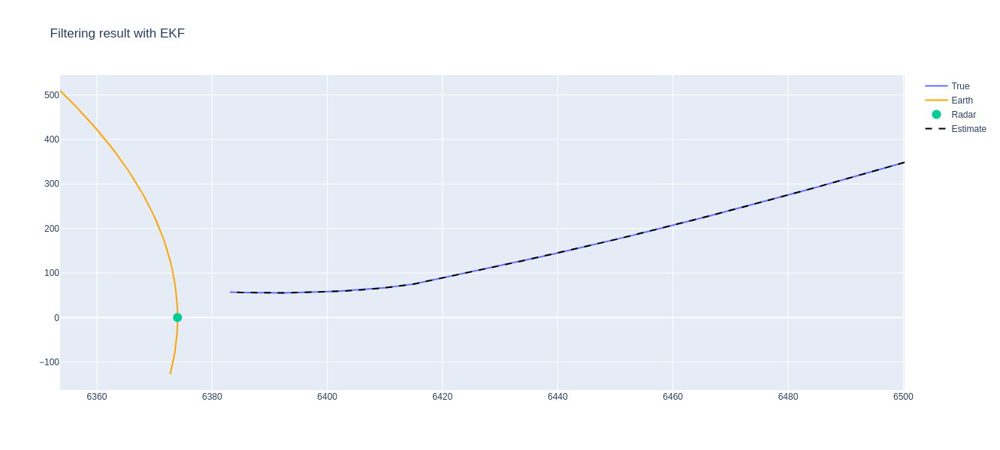

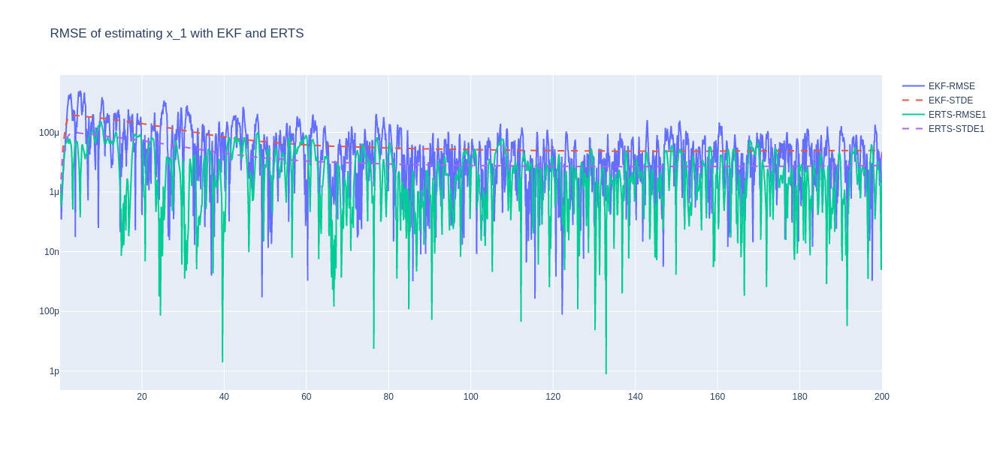

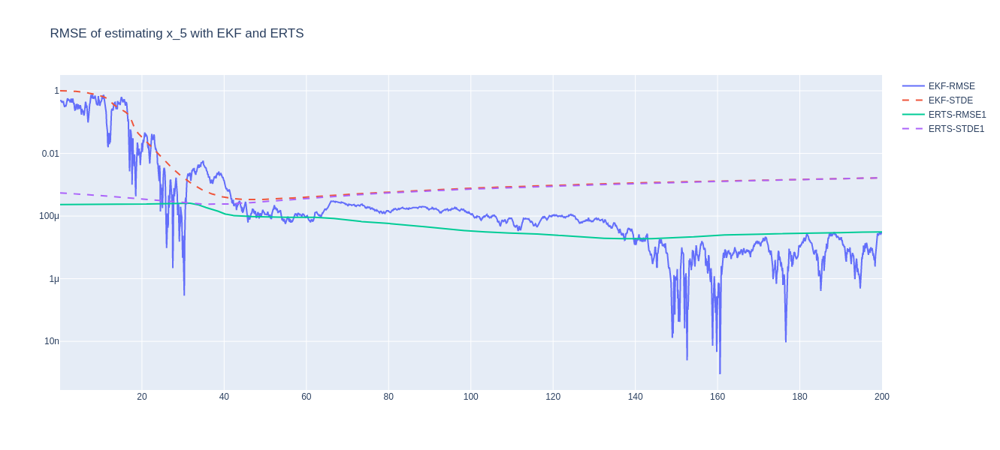


# UKF =========================================================================================


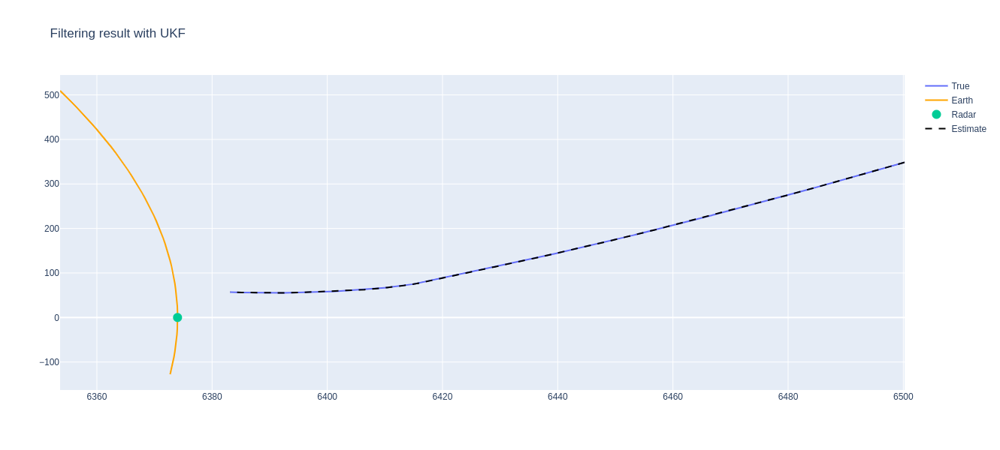

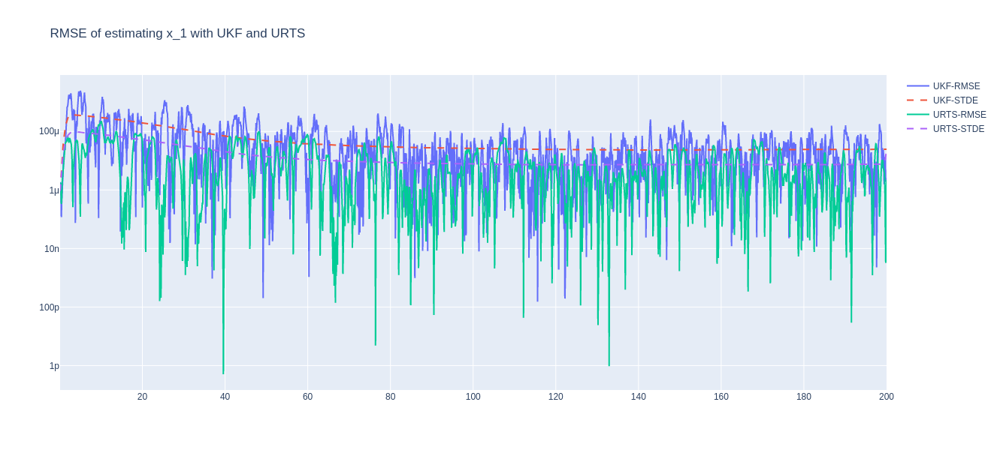

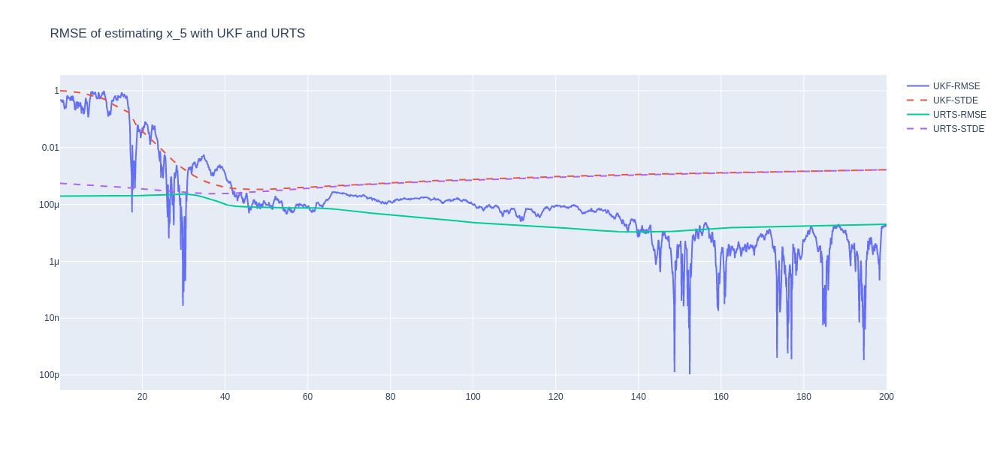


# GHKF =========================================================================================


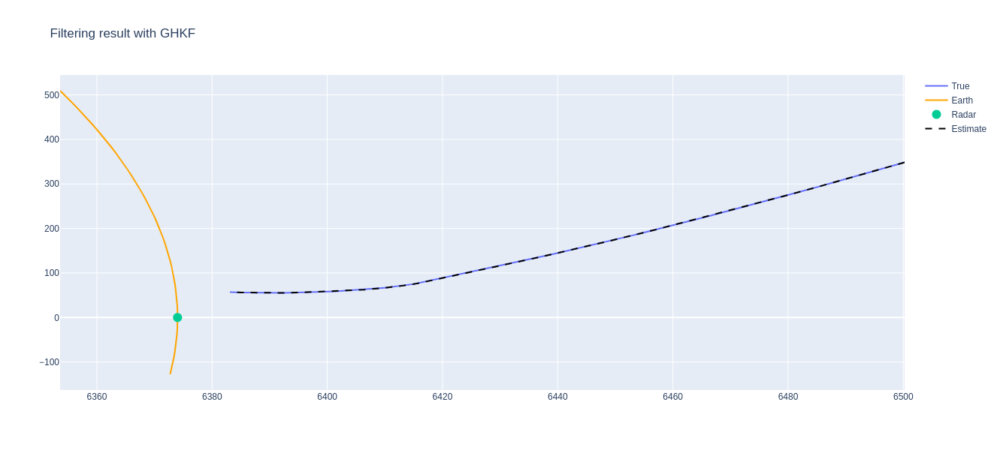

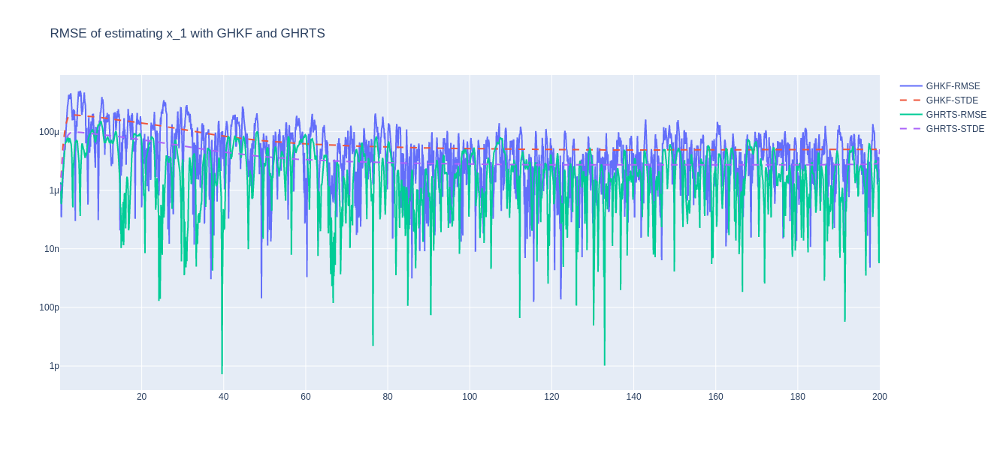

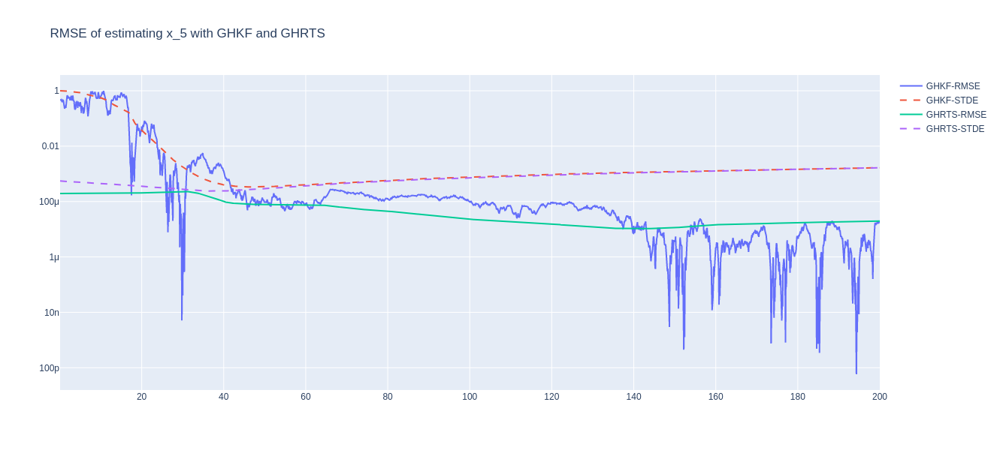


# CKF =========================================================================================


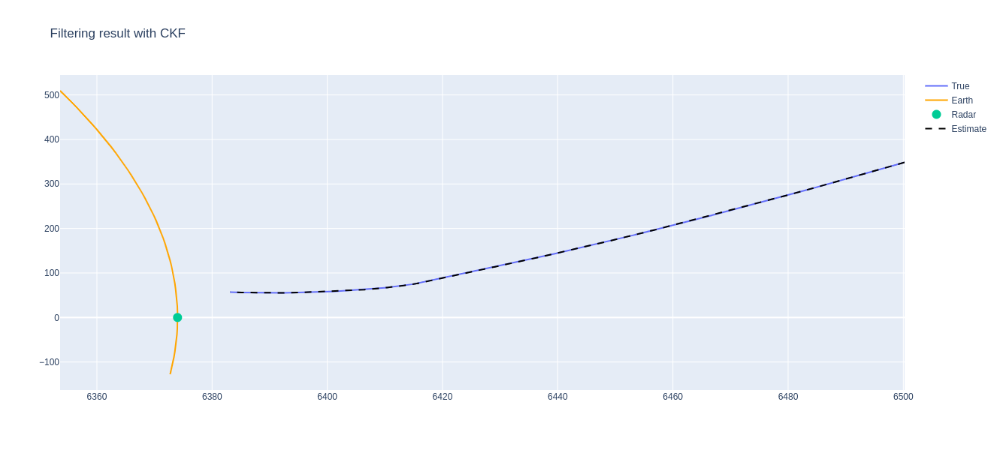

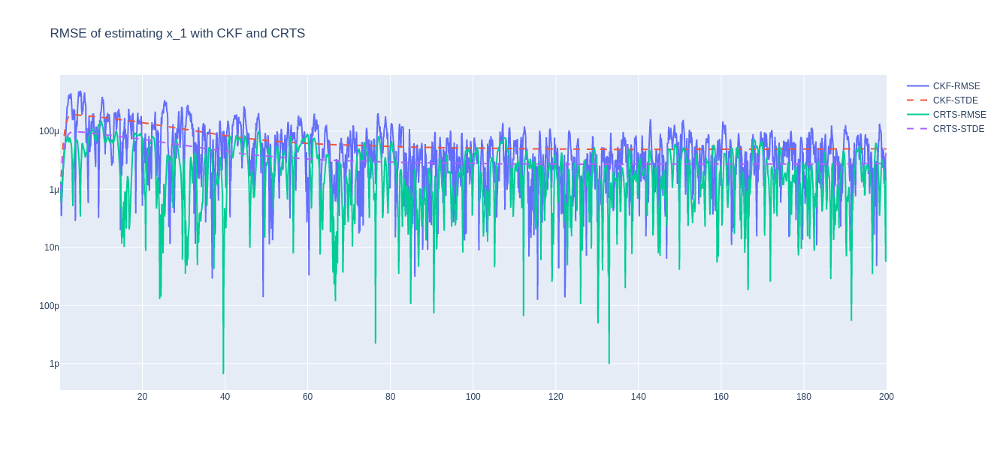

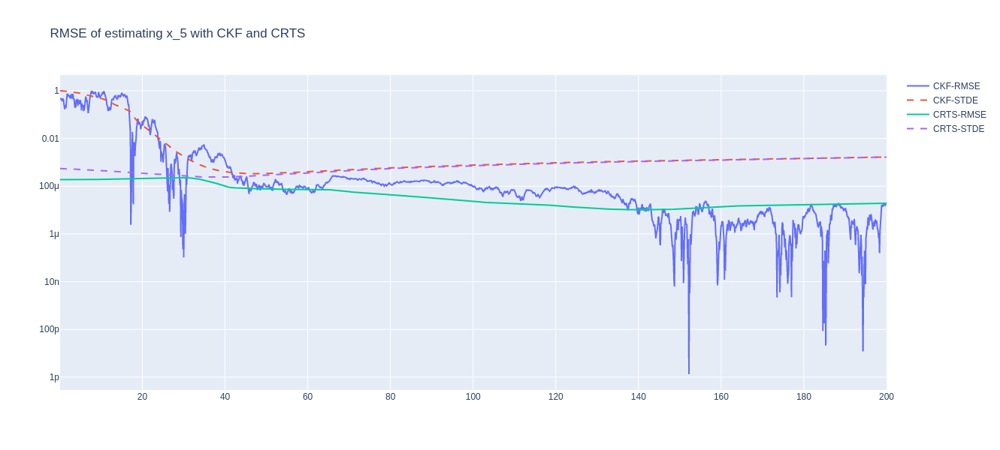

In [14]:
###############################################################################
## Visualize methods
###############################################################################

if not silent:
    print('\n# EKF =========================================================================================')
    # Plot EKF estimate
    fig = go.Figure()
    fig.add_scatter(x=X[:,0,0], y=X[:,1,0], name='True')
    fig.add_scatter(x=cx, y=cy, line_color='orange', name='Earth')
    fig.add_scatter(x=[xr], y=[yr], mode='markers', marker_size=12, name='Radar')
    fig.add_scatter(x=MM_EKF[:,0,0], y=MM_EKF[:,1,0], line_dash='dash', line_color='black', name='Estimate')
    fig.layout.update(title='Filtering result with EKF', height=600)
    fig.show()

    # Error for x_1 with EKF
    fig = go.Figure()
    fig.add_scatter(x=T, y=EE_EKF[:,0,0], name='EKF-RMSE')
    fig.add_scatter(x=T, y=VV_EKF[:,0], line_dash='dash', name='EKF-STDE')
    fig.add_scatter(x=T, y=SE_ERTS[:,0,0], name='ERTS-RMSE1')
    fig.add_scatter(x=T, y=SV_ERTS[:,0], line_dash='dash', name='ERTS-STDE1')
    fig.layout.update(title='RMSE of estimating x_1 with EKF and ERTS', yaxis_type="log", height=600)
    fig.show()
    
    # Error for x_5 with EKF
    fig = go.Figure()
    fig.add_scatter(x=T, y=EE_EKF[:,4,0], name='EKF-RMSE')
    fig.add_scatter(x=T, y=VV_EKF[:,4], line_dash='dash', name='EKF-STDE')
    fig.add_scatter(x=T, y=SE_ERTS[:,4,0], name='ERTS-RMSE1')
    fig.add_scatter(x=T, y=SV_ERTS[:,4], line_dash='dash', name='ERTS-STDE1')
    fig.layout.update(title='RMSE of estimating x_5 with EKF and ERTS', yaxis_type="log", height=600)
    fig.show()
    
    print('\n# UKF =========================================================================================')
    # Plot UKF estimate
    fig = go.Figure()
    fig.add_scatter(x=X[:,0,0], y=X[:,1,0], name='True')
    fig.add_scatter(x=cx, y=cy, line_color='orange', name='Earth')
    fig.add_scatter(x=[xr], y=[yr], mode='markers', marker_size=12, name='Radar')
    fig.add_scatter(x=MM_UKF[:,0,0], y=MM_UKF[:,1,0], line_dash='dash', line_color='black',name='Estimate')
    fig.layout.update(title='Filtering result with UKF', height=600)
    fig.show()
    
    # Error for x_1 with UKF
    fig = go.Figure()
    fig.add_scatter(x=T, y=EE_UKF[:,0,0], name='UKF-RMSE')
    fig.add_scatter(x=T, y=VV_UKF[:,0], line_dash='dash', name='UKF-STDE')
    fig.add_scatter(x=T, y=SE_URTS[:,0,0], name='URTS-RMSE')
    fig.add_scatter(x=T, y=SV_URTS[:,0], line_dash='dash', name='URTS-STDE')
    fig.layout.update(title='RMSE of estimating x_1 with UKF and URTS', yaxis_type="log", height=600)
    fig.show()
    
    # Error for x_5 with UKF
    fig = go.Figure()
    fig.add_scatter(x=T, y=EE_UKF[:,4,0], name='UKF-RMSE')
    fig.add_scatter(x=T, y=VV_UKF[:,4], line_dash='dash', name='UKF-STDE')
    fig.add_scatter(x=T, y=SE_URTS[:,4,0], name='URTS-RMSE')
    fig.add_scatter(x=T, y=SV_URTS[:,4], line_dash='dash', name='URTS-STDE')
    fig.layout.update(title='RMSE of estimating x_5 with UKF and URTS', yaxis_type="log", height=600)
    fig.show()

    print('\n# GHKF =========================================================================================')
    # Plot GHKF estimate
    fig = go.Figure()
    fig.add_scatter(x=X[:,0,0], y=X[:,1,0], name='True')
    fig.add_scatter(x=cx, y=cy, line_color='orange', name='Earth')
    fig.add_scatter(x=[xr], y=[yr], mode='markers', marker_size=12, name='Radar')
    fig.add_scatter(x=MM_GHKF[:,0,0], y=MM_GHKF[:,1,0], line_dash='dash', line_color='black',name='Estimate')
    fig.layout.update(title='Filtering result with GHKF', height=600)
    fig.show()
    
    # Error for x_1 with GHKF
    fig = go.Figure()
    fig.add_scatter(x=T, y=EE_GHKF[:,0,0], name='GHKF-RMSE')
    fig.add_scatter(x=T, y=VV_GHKF[:,0], line_dash='dash', name='GHKF-STDE')
    fig.add_scatter(x=T, y=SE_GHRTS[:,0,0], name='GHRTS-RMSE')
    fig.add_scatter(x=T, y=SV_GHRTS[:,0], line_dash='dash', name='GHRTS-STDE')
    fig.layout.update(title='RMSE of estimating x_1 with GHKF and GHRTS', yaxis_type="log", height=600)
    fig.show()
    
    # Error for x_5 with GHKF
    fig = go.Figure()
    fig.add_scatter(x=T, y=EE_GHKF[:,4,0], name='GHKF-RMSE')
    fig.add_scatter(x=T, y=VV_GHKF[:,4], line_dash='dash', name='GHKF-STDE')
    fig.add_scatter(x=T, y=SE_GHRTS[:,4,0], name='GHRTS-RMSE')
    fig.add_scatter(x=T, y=SV_GHRTS[:,4], line_dash='dash', name='GHRTS-STDE')
    fig.layout.update(title='RMSE of estimating x_5 with GHKF and GHRTS', yaxis_type="log", height=600)
    fig.show()
    
    print('\n# CKF =========================================================================================')
    # Plot CKF estimate
    fig = go.Figure()
    fig.add_scatter(x=X[:,0,0], y=X[:,1,0], name='True')
    fig.add_scatter(x=cx, y=cy, line_color='orange', name='Earth')
    fig.add_scatter(x=[xr], y=[yr], mode='markers', marker_size=12, name='Radar')
    fig.add_scatter(x=MM_CKF[:,0,0], y=MM_CKF[:,1,0], line_dash='dash', line_color='black',name='Estimate')
    fig.layout.update(title='Filtering result with CKF', height=600)
    fig.show()
    
    # Error for x_1 with CKF
    fig = go.Figure()
    fig.add_scatter(x=T, y=EE_CKF[:,0,0], name='CKF-RMSE')
    fig.add_scatter(x=T, y=VV_CKF[:,0], line_dash='dash', name='CKF-STDE')
    fig.add_scatter(x=T, y=SE_CRTS[:,0,0], name='CRTS-RMSE')
    fig.add_scatter(x=T, y=SV_CRTS[:,0], line_dash='dash', name='CRTS-STDE')
    fig.layout.update(title='RMSE of estimating x_1 with CKF and CRTS', yaxis_type="log", height=600)
    fig.show()
    
    # Error for x_5 with CKF
    fig = go.Figure()
    fig.add_scatter(x=T, y=EE_CKF[:,4,0], name='CKF-RMSE')
    fig.add_scatter(x=T, y=VV_CKF[:,4], line_dash='dash', name='CKF-STDE')
    fig.add_scatter(x=T, y=SE_CRTS[:,4,0], name='CRTS-RMSE')
    fig.add_scatter(x=T, y=SV_CRTS[:,4], line_dash='dash', name='CRTS-STDE')
    fig.layout.update(title='RMSE of estimating x_5 with CKF and CRTS', yaxis_type="log", height=600)
    fig.show()

In [15]:
## Show RMSE errors for each method
if not silent:
    print('RMSE errors:')
    print('EKF-RMSE   = {:2f}\t[{:4f}]\nERTS-RMSE  = {:2f}\t[{:4f}]\nETF-RMSE   = {:2f}\t[{:4f}]\n\
UKF-RMSE   = {:2f}\t[{:4f}]\nURTS1-RMSE = {:2f}\t[{:4f}]\nURTS2-RMSE = {:2f}\t[{:4f}]\n\
UTF-RMSE   = {:2f}\t[{:4f}]\n\nCurbature Methods:\nGHKF-RMSE  = {:2f}\t[{:4f}]\n\
GHRTS-RMSE = {:2f}\t[{:4f}]\nCKF-RMSE   = {:2f}\t[{:4f}]\nCRTS-RMSE  = {:2f}\t[{:4f}]\n'.format(*[ekf_rmse, np.sqrt(np.mean(ME_EKF)),
                                                                                                  eks_rmse1, np.sqrt(np.mean(ME_ERTS)),
                                                                                                  eks_rmse2, np.sqrt(np.mean(ME_ETF)),
                                                                                                  ukf_rmse, np.sqrt(np.mean(ME_UKF)),
                                                                                                  uks_rmse1, np.sqrt(np.mean(ME_URTS)),
                                                                                                  uks_rmse1b, np.sqrt(np.mean(ME_URTSb)),
                                                                                                  uks_rmse2, np.sqrt(np.mean(ME_UTF)),
                                                                                                  ghkf_rmse, np.sqrt(np.mean(ME_GHKF)),
                                                                                                  ghrts_rmse1, np.sqrt(np.mean(ME_GHRTS)),
                                                                                                  ckf_rmse, np.sqrt(np.mean(ME_CKF)),
                                                                                                  crts_rmse1, np.sqrt(np.mean(ME_CRTS))]))

RMSE errors:
EKF-RMSE   = 0.009834	[0.008566]
ERTS-RMSE  = 0.004074	[0.004526]
ETF-RMSE   = 0.044257	[0.002984]
UKF-RMSE   = 0.009838	[0.008566]
URTS1-RMSE = 0.004073	[0.004526]
URTS2-RMSE = 0.004073	[0.004526]
UTF-RMSE   = 0.004054	[0.004632]

Curbature Methods:
GHKF-RMSE  = 0.009837	[0.008566]
GHRTS-RMSE = 0.004073	[0.004526]
CKF-RMSE   = 0.009838	[0.008566]
CRTS-RMSE  = 0.004073	[0.004526]

